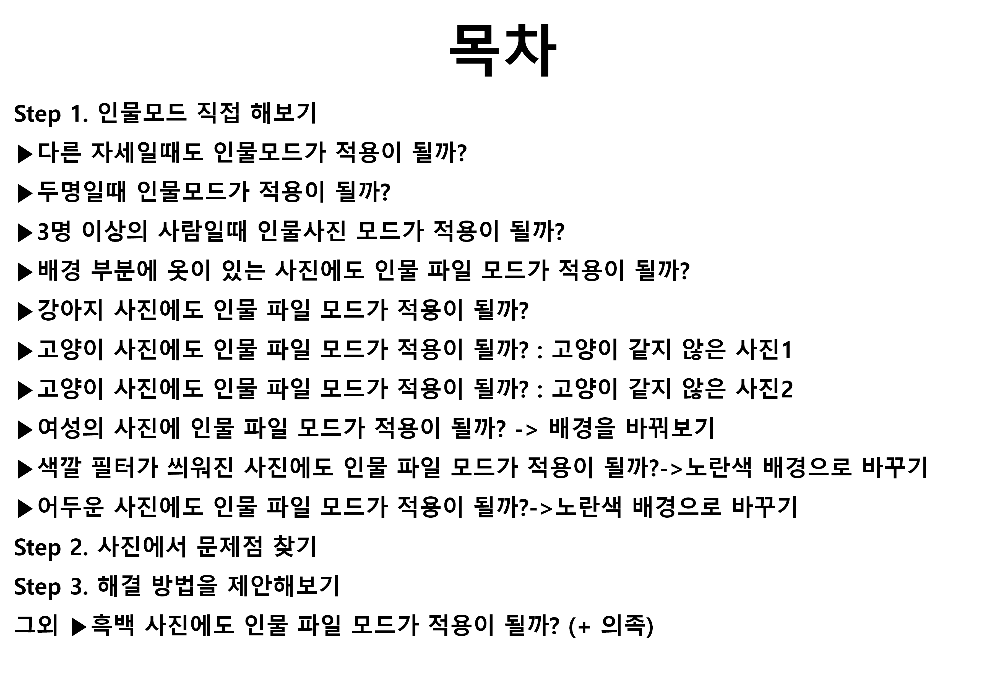

### 학습목표
딥러닝을 적용하여 핸드폰 인물 사진 모드를 따라해보자

### 준비물 - 파일 만들어두기
#### mkdir -p ~/aiffel/human_segmentation/models
#### mkdir -p ~/aiffel/human_segmentation/images

# Step 1. 인물모드 직접 해 보기

In [1]:
import os
import urllib #웹에서 데이터 다운로드
import cv2 #OpenCV 라이브러리로 이미지 처리
import numpy as np
from pixellib.semantic import semantic_segmentation #시맨틱 세그멘테이션 사용
from matplotlib import pyplot as plt
from PIL import Image

print('import 완료!')

import 완료!


In [2]:
# 저장할 파일 이름을 결정합니다
model_dir = os.getenv('HOME')+'/aiffel/human_segmentation/models'
model_file = os.path.join(model_dir, 'deeplabv3_xception_tf_dim_ordering_tf_kernels.h5')

# PixelLib가 제공하는 모델의 url입니다
model_url = 'https://github.com/ayoolaolafenwa/PixelLib/releases/download/1.1/deeplabv3_xception_tf_dim_ordering_tf_kernels.h5'

# 다운로드를 시작합니다
urllib.request.urlretrieve(model_url, model_file)

('/aiffel/aiffel/human_segmentation/models/deeplabv3_xception_tf_dim_ordering_tf_kernels.h5',
 <http.client.HTTPMessage at 0x7f156746a400>)

In [3]:
model = semantic_segmentation()
model.load_pascalvoc_model(model_file)

## ▶다른 자세일때도 인물모드가 적용이 될까? 

(3072, 4608, 3)


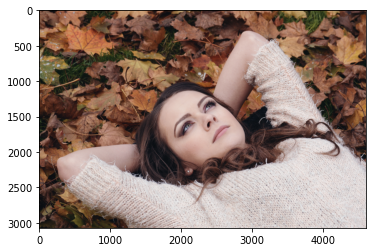

In [4]:
woman_fall_path = os.getenv('HOME')+'/aiffel/human_segmentation/images/woman_fall.png'  
woman_fall_orig = cv2.imread(woman_fall_path) 

print(woman_fall_orig.shape)
plt.imshow(cv2.cvtColor(woman_fall_orig, cv2.COLOR_BGR2RGB))
plt.show()

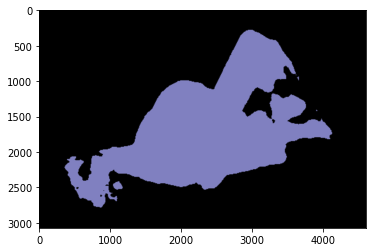

In [5]:
segvalues, output = model.segmentAsPascalvoc(woman_fall_path)
LABEL_NAMES = [
    'background', 'aeroplane', 'bicycle', 'bird', 'boat', 'bottle', 'bus',
    'car', 'cat', 'chair', 'cow', 'diningtable', 'dog', 'horse', 'motorbike',
    'person', 'pottedplant', 'sheep', 'sofa', 'train', 'tv'
]
plt.imshow(output)
plt.show()

In [6]:
for class_id in segvalues['class_ids']:
    print(LABEL_NAMES[class_id])

background
person


In [7]:
colormap = np.zeros((256, 3), dtype = int)
ind = np.arange(256, dtype=int)

for shift in reversed(range(8)):
    for channel in range(3):
        colormap[:, channel] |= ((ind >> channel) & 1) << shift
    ind >>= 3

colormap[15]

array([192, 128, 128])

In [8]:
seg_color = (128,128,192)

(3072, 4608)


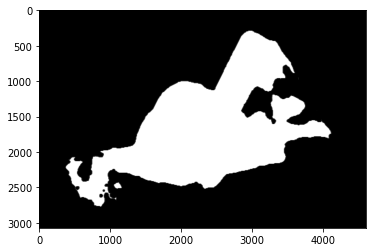

In [9]:
seg_map = np.all(output==seg_color, axis=-1)
print(seg_map.shape)
plt.imshow(seg_map, cmap='gray')
plt.show()

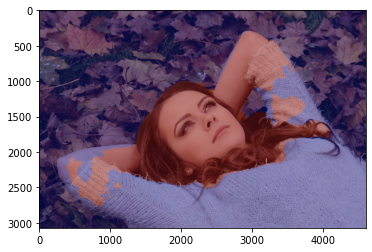

In [10]:
woman_fall_show = woman_fall_orig.copy()

woman_fall_mask = seg_map.astype(np.uint8) * 255

color_mask = cv2.applyColorMap(woman_fall_mask, cv2.COLORMAP_JET)

woman_fall_show = cv2.addWeighted(woman_fall_show, 0.6, color_mask, 0.4, 0.0)

plt.imshow(cv2.cvtColor(woman_fall_show, cv2.COLOR_BGR2RGB))
plt.show()

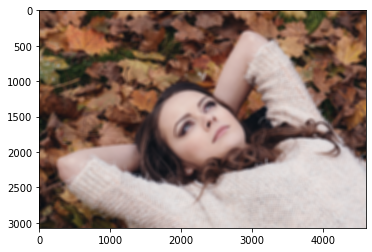

In [11]:
woman_fall_orig_blur = cv2.blur(woman_fall_orig, (50,50))  
plt.imshow(cv2.cvtColor(woman_fall_orig_blur, cv2.COLOR_BGR2RGB))
plt.show()

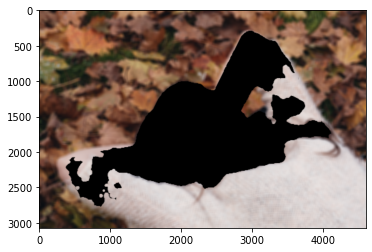

In [12]:
woman_fall_mask_color = cv2.cvtColor(woman_fall_mask, cv2.COLOR_GRAY2BGR)
woman_fall_bg_mask = cv2.bitwise_not(woman_fall_mask_color)
woman_fall_bg_blur = cv2.bitwise_and(woman_fall_orig_blur, woman_fall_bg_mask)
plt.imshow(cv2.cvtColor(woman_fall_bg_blur, cv2.COLOR_BGR2RGB))
plt.show()

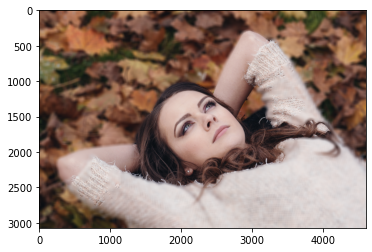

In [13]:
woman_fall_concat = np.where(woman_fall_mask_color==255, woman_fall_orig, woman_fall_bg_blur)
plt.imshow(cv2.cvtColor(woman_fall_concat, cv2.COLOR_BGR2RGB))
plt.show()

## ▶두명일때 인물모드가 적용이 될까?

(3840, 5760, 3)


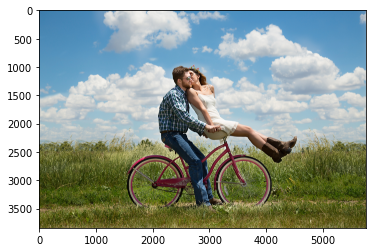

In [14]:
couple_path = os.getenv('HOME')+'/aiffel/human_segmentation/images/couple.png'  
couple_orig = cv2.imread(couple_path) 

print(couple_orig.shape)
plt.imshow(cv2.cvtColor(couple_orig, cv2.COLOR_BGR2RGB))
plt.show()

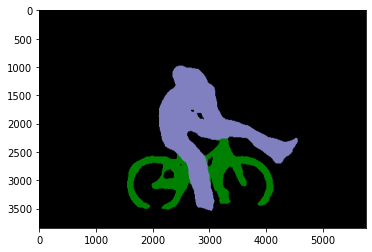

In [15]:
segvalues, output = model.segmentAsPascalvoc(couple_path)
LABEL_NAMES = [
    'background', 'aeroplane', 'bicycle', 'bird', 'boat', 'bottle', 'bus',
    'car', 'cat', 'chair', 'cow', 'diningtable', 'dog', 'horse', 'motorbike',
    'person', 'pottedplant', 'sheep', 'sofa', 'train', 'tv'
]
plt.imshow(output)
plt.show()

In [16]:
for class_id in segvalues['class_ids']:
    print(LABEL_NAMES[class_id])

background
bicycle
person


In [17]:
colormap = np.zeros((256, 3), dtype = int)
ind = np.arange(256, dtype=int)

for shift in reversed(range(8)):
    for channel in range(3):
        colormap[:, channel] |= ((ind >> channel) & 1) << shift
    ind >>= 3

colormap[15]

array([192, 128, 128])

In [18]:
seg_color = (128,128,192)

(3840, 5760)


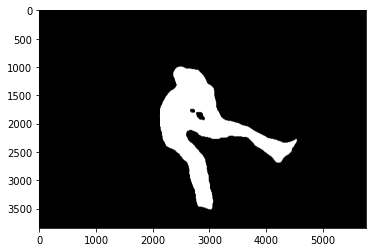

In [19]:
seg_map = np.all(output==seg_color, axis=-1)
print(seg_map.shape)
plt.imshow(seg_map, cmap='gray')
plt.show()

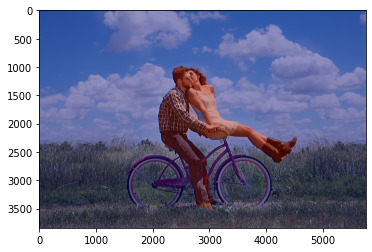

In [20]:
couple_show = couple_orig.copy()

couple_mask = seg_map.astype(np.uint8) * 255

color_mask = cv2.applyColorMap(couple_mask, cv2.COLORMAP_JET)

couple_show = cv2.addWeighted(couple_show, 0.6, color_mask, 0.4, 0.0)

plt.imshow(cv2.cvtColor(couple_show, cv2.COLOR_BGR2RGB))
plt.show()

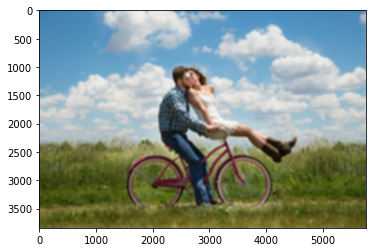

In [21]:
couple_orig_blur = cv2.blur(couple_orig, (50,50))  
plt.imshow(cv2.cvtColor(couple_orig_blur, cv2.COLOR_BGR2RGB))
plt.show()

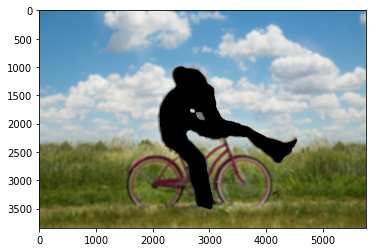

In [22]:
couple_mask_color = cv2.cvtColor(couple_mask, cv2.COLOR_GRAY2BGR)
couple_bg_mask = cv2.bitwise_not(couple_mask_color)
couple_bg_blur = cv2.bitwise_and(couple_orig_blur, couple_bg_mask)
plt.imshow(cv2.cvtColor(couple_bg_blur, cv2.COLOR_BGR2RGB))
plt.show()

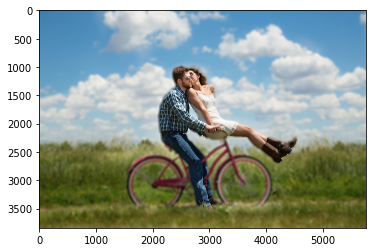

In [23]:
couple_concat = np.where(couple_mask_color==255, couple_orig, couple_bg_blur)
plt.imshow(cv2.cvtColor(couple_concat, cv2.COLOR_BGR2RGB))
plt.show()

## ▶3명 이상의 사람일때 인물사진 모드가 적용이 될까?

(2967, 4450, 3)


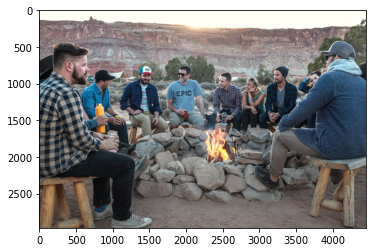

In [24]:
people_path = os.getenv('HOME')+'/aiffel/human_segmentation/images/people.png'  
people_orig = cv2.imread(people_path) 

print(people_orig.shape)
plt.imshow(cv2.cvtColor(people_orig, cv2.COLOR_BGR2RGB))
plt.show()

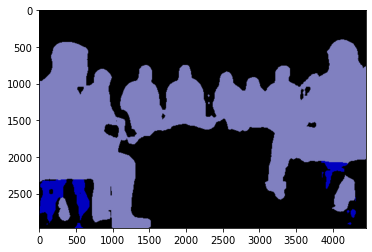

In [25]:
segvalues, output = model.segmentAsPascalvoc(people_path)
LABEL_NAMES = [
    'background', 'aeroplane', 'bicycle', 'bird', 'boat', 'bottle', 'bus',
    'car', 'cat', 'chair', 'cow', 'diningtable', 'dog', 'horse', 'motorbike',
    'person', 'pottedplant', 'sheep', 'sofa', 'train', 'tv'
]
plt.imshow(output)
plt.show()

In [26]:
for class_id in segvalues['class_ids']:
    print(LABEL_NAMES[class_id])

background
chair
person


In [27]:
colormap = np.zeros((256, 3), dtype = int)
ind = np.arange(256, dtype=int)

for shift in reversed(range(8)):
    for channel in range(3):
        colormap[:, channel] |= ((ind >> channel) & 1) << shift
    ind >>= 3

colormap[15]

array([192, 128, 128])

In [28]:
seg_color = (128,128,192)

(2967, 4450)


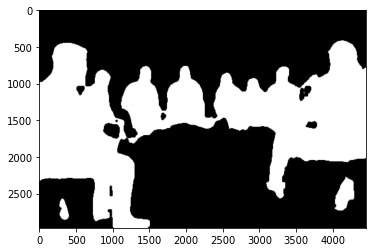

In [29]:
seg_map = np.all(output==seg_color, axis=-1)
print(seg_map.shape)
plt.imshow(seg_map, cmap='gray')
plt.show()

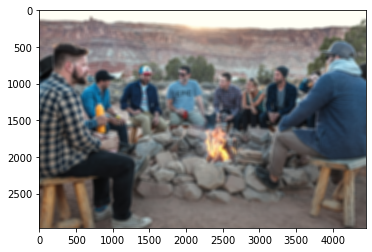

In [30]:
people_show = people_orig.copy()

people_mask = seg_map.astype(np.uint8) * 255

color_mask = cv2.applyColorMap(people_mask, cv2.COLORMAP_JET)

people_show = cv2.addWeighted(people_show, 0.6, color_mask, 0.4, 0.0)

plt.imshow(cv2.cvtColor(people_show, cv2.COLOR_BGR2RGB))

people_orig_blur = cv2.blur(people_orig, (50,50))  
plt.imshow(cv2.cvtColor(people_orig_blur, cv2.COLOR_BGR2RGB))
plt.show()

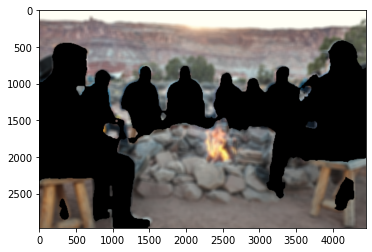

In [31]:
people_mask_color = cv2.cvtColor(people_mask, cv2.COLOR_GRAY2BGR)
people_bg_mask = cv2.bitwise_not(people_mask_color)
people_bg_blur = cv2.bitwise_and(people_orig_blur, people_bg_mask)
plt.imshow(cv2.cvtColor(people_bg_blur, cv2.COLOR_BGR2RGB))
plt.show()

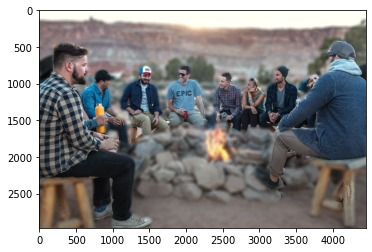

In [32]:
people_concat = np.where(people_mask_color==255, people_orig, people_bg_blur)
plt.imshow(cv2.cvtColor(people_concat, cv2.COLOR_BGR2RGB))
plt.show()

## ▶배경 부분에 옷이 있는 사진에도 인물 파일 모드가 적용이 될까?

(4000, 6000, 3)


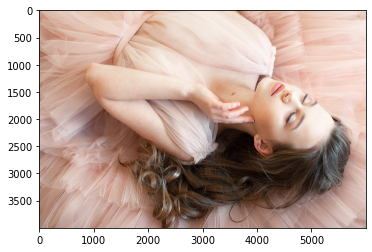

In [33]:
woman_dress_path = os.getenv('HOME')+'/aiffel/human_segmentation/images/woman_dress.png'  
woman_dress_orig = cv2.imread(woman_dress_path) 

print(woman_dress_orig.shape)
plt.imshow(cv2.cvtColor(woman_dress_orig, cv2.COLOR_BGR2RGB))
plt.show()

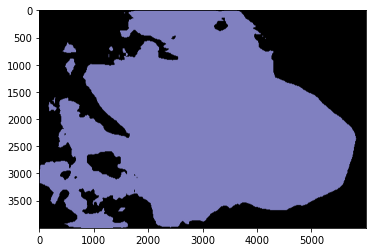

In [34]:
segvalues, output = model.segmentAsPascalvoc(woman_dress_path)
LABEL_NAMES = [
    'background', 'aeroplane', 'bicycle', 'bird', 'boat', 'bottle', 'bus',
    'car', 'cat', 'chair', 'cow', 'diningtable', 'dog', 'horse', 'motorbike',
    'person', 'pottedplant', 'sheep', 'sofa', 'train', 'tv'
]
plt.imshow(output)
plt.show()

In [35]:
for class_id in segvalues['class_ids']:
    print(LABEL_NAMES[class_id])

background
person


(4000, 6000)


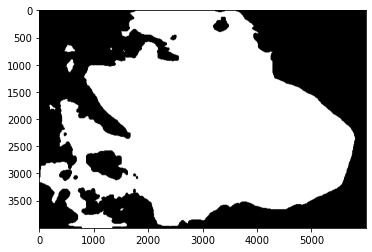

In [36]:
colormap = np.zeros((256, 3), dtype = int)
ind = np.arange(256, dtype=int)

for shift in reversed(range(8)):
    for channel in range(3):
        colormap[:, channel] |= ((ind >> channel) & 1) << shift
    ind >>= 3

seg_color = (128,128,192)

seg_map = np.all(output==seg_color, axis=-1)
print(seg_map.shape)
plt.imshow(seg_map, cmap='gray')
plt.show()

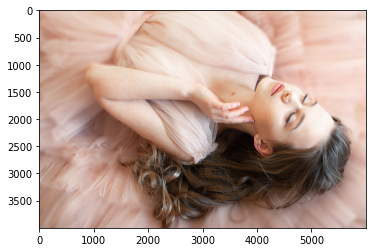

In [37]:
woman_dress_show = woman_dress_orig.copy()

woman_dress_mask = seg_map.astype(np.uint8) * 255

color_mask = cv2.applyColorMap(woman_dress_mask, cv2.COLORMAP_JET)

woman_dress_show = cv2.addWeighted(woman_dress_show, 0.6, color_mask, 0.4, 0.0)

plt.imshow(cv2.cvtColor(woman_dress_show, cv2.COLOR_BGR2RGB))

woman_dress_orig_blur = cv2.blur(woman_dress_orig, (70,70))  

woman_dress_mask_color = cv2.cvtColor(woman_dress_mask, cv2.COLOR_GRAY2BGR)
woman_dress_bg_mask = cv2.bitwise_not(woman_dress_mask_color)
woman_dress_bg_blur = cv2.bitwise_and(woman_dress_orig_blur, woman_dress_bg_mask)

woman_dress_concat = np.where(woman_dress_mask_color==255, woman_dress_orig, woman_dress_bg_blur)
plt.imshow(cv2.cvtColor(woman_dress_concat, cv2.COLOR_BGR2RGB))
plt.show()

## ▶강아지 사진에도 인물 파일 모드가 적용이 될까?

(3456, 5184, 3)


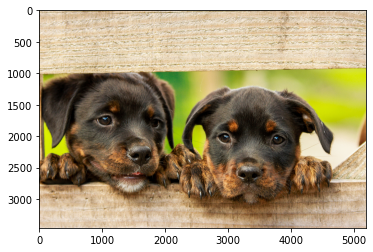

In [38]:
dog_path = os.getenv('HOME')+'/aiffel/human_segmentation/images/dog.png'  
dog_orig = cv2.imread(dog_path) 

print(dog_orig.shape)
plt.imshow(cv2.cvtColor(dog_orig, cv2.COLOR_BGR2RGB))
plt.show()

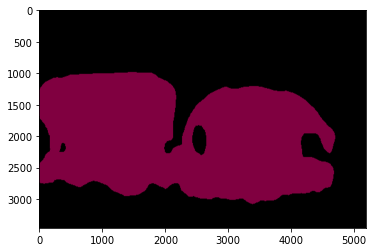

In [39]:
segvalues, output = model.segmentAsPascalvoc(dog_path)
LABEL_NAMES = [
    'background', 'aeroplane', 'bicycle', 'bird', 'boat', 'bottle', 'bus',
    'car', 'cat', 'chair', 'cow', 'diningtable', 'dog', 'horse', 'motorbike',
    'person', 'pottedplant', 'sheep', 'sofa', 'train', 'tv'
]
plt.imshow(output)
plt.show()

(3456, 5184)


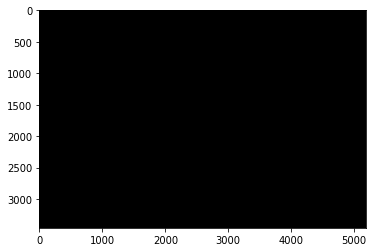

In [40]:
colormap = np.zeros((256, 3), dtype = int)
ind = np.arange(256, dtype=int)

for shift in reversed(range(8)):
    for channel in range(3):
        colormap[:, channel] |= ((ind >> channel) & 1) << shift
    ind >>= 3

seg_color = (128,128,192)

seg_map = np.all(output==seg_color, axis=-1)
print(seg_map.shape)
plt.imshow(seg_map, cmap='gray')
plt.show()

## <span style="color:red">※강아지는 인물이 아니기 때문에 사람을 나타내는 색상인 colormap[15]값을 사용 하면 안된다!!</span>
## <span style="color:red">강아지는 12, 고양이는 8로 하자!</span>

In [41]:
colormap = np.zeros((256, 3), dtype = int)
ind = np.arange(256, dtype=int)

for shift in reversed(range(8)):
    for channel in range(3):
        colormap[:, channel] |= ((ind >> channel) & 1) << shift
    ind >>= 3

colormap[12] #BGR 순서

array([ 64,   0, 128])

(3456, 5184)


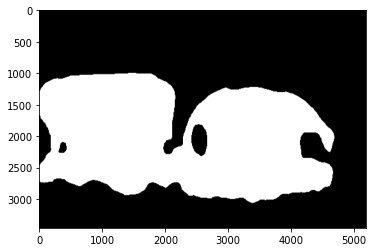

In [42]:
seg_color = (128,0,64) #RGB 순서

seg_map = np.all(output==seg_color, axis=-1)
print(seg_map.shape)
plt.imshow(seg_map, cmap='gray')
plt.show()

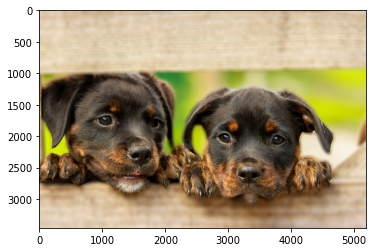

In [43]:
dog_show = dog_orig.copy()

dog_mask = seg_map.astype(np.uint8) * 255

color_mask = cv2.applyColorMap(dog_mask, cv2.COLORMAP_JET)

dog_show = cv2.addWeighted(dog_show, 0.6, color_mask, 0.4, 0.0)

plt.imshow(cv2.cvtColor(dog_show, cv2.COLOR_BGR2RGB))

dog_orig_blur = cv2.blur(dog_orig, (70,70))  

dog_mask_color = cv2.cvtColor(dog_mask, cv2.COLOR_GRAY2BGR)
dog_bg_mask = cv2.bitwise_not(dog_mask_color)
dog_bg_blur = cv2.bitwise_and(dog_orig_blur, dog_bg_mask)

dog_concat = np.where(dog_mask_color==255, dog_orig, dog_bg_blur)
plt.imshow(cv2.cvtColor(dog_concat, cv2.COLOR_BGR2RGB))
plt.show()

## ▶고양이 사진에도 인물 파일 모드가 적용이 될까? : 고양이 같지 않은 사진1

(1459, 1920, 3)


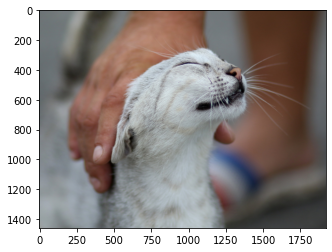

In [44]:
cat_path = os.getenv('HOME')+'/aiffel/human_segmentation/images/cat.jpg'  
cat_orig = cv2.imread(cat_path) 

print(cat_orig.shape)
plt.imshow(cv2.cvtColor(cat_orig, cv2.COLOR_BGR2RGB))
plt.show()

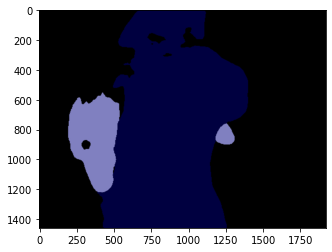

In [45]:
segvalues, output = model.segmentAsPascalvoc(cat_path)
LABEL_NAMES = [
    'background', 'aeroplane', 'bicycle', 'bird', 'boat', 'bottle', 'bus',
    'car', 'cat', 'chair', 'cow', 'diningtable', 'dog', 'horse', 'motorbike',
    'person', 'pottedplant', 'sheep', 'sofa', 'train', 'tv'
]
plt.imshow(output)
plt.show()

In [46]:
colormap = np.zeros((256, 3), dtype = int)
ind = np.arange(256, dtype=int)

for shift in reversed(range(8)):
    for channel in range(3):
        colormap[:, channel] |= ((ind >> channel) & 1) << shift
    ind >>= 3

colormap[8] #BGR 순서

array([64,  0,  0])

(1459, 1920)


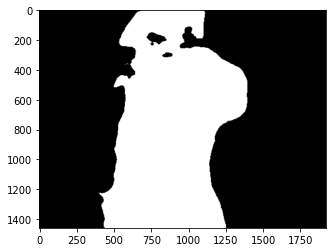

In [47]:
seg_color = (0,0,64) #RGB 순서

seg_map = np.all(output==seg_color, axis=-1)
print(seg_map.shape)
plt.imshow(seg_map, cmap='gray')
plt.show()

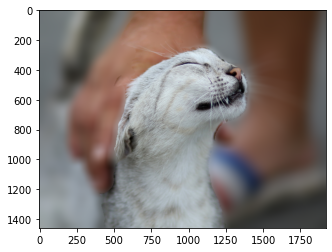

In [48]:
cat_show = cat_orig.copy()

cat_mask = seg_map.astype(np.uint8) * 255

color_mask = cv2.applyColorMap(cat_mask, cv2.COLORMAP_JET)

cat_show = cv2.addWeighted(cat_show, 0.6, color_mask, 0.4, 0.0)

plt.imshow(cv2.cvtColor(cat_show, cv2.COLOR_BGR2RGB))

cat_orig_blur = cv2.blur(cat_orig, (70,70))  

cat_mask_color = cv2.cvtColor(cat_mask, cv2.COLOR_GRAY2BGR)
cat_bg_mask = cv2.bitwise_not(cat_mask_color)
cat_bg_blur = cv2.bitwise_and(cat_orig_blur, cat_bg_mask)

cat_concat = np.where(cat_mask_color==255, cat_orig, cat_bg_blur)
plt.imshow(cv2.cvtColor(cat_concat, cv2.COLOR_BGR2RGB))
plt.show()

## ▶고양이 사진에도 인물 파일 모드가 적용이 될까? : 고양이 같지 않은 사진2

(1100, 1920, 3)


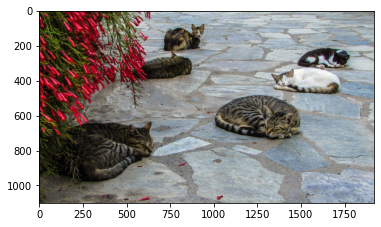

In [49]:
cats_path = os.getenv('HOME')+'/aiffel/human_segmentation/images/cats.jpg'  
cats_orig = cv2.imread(cats_path) 

print(cats_orig.shape)
plt.imshow(cv2.cvtColor(cats_orig, cv2.COLOR_BGR2RGB))
plt.show()

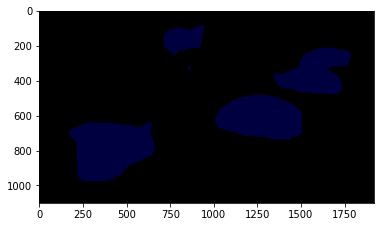

In [50]:
segvalues, output = model.segmentAsPascalvoc(cats_path)
LABEL_NAMES = [
    'background', 'aeroplane', 'bicycle', 'bird', 'boat', 'bottle', 'bus',
    'car', 'cat', 'chair', 'cow', 'diningtable', 'dog', 'horse', 'motorbike',
    'person', 'pottedplant', 'sheep', 'sofa', 'train', 'tv'
]
plt.imshow(output)
plt.show()

(1100, 1920)


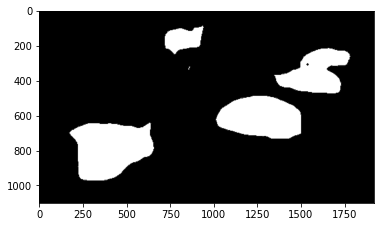

In [51]:
seg_color = (0,0,64) #RGB 순서

seg_map = np.all(output==seg_color, axis=-1)
print(seg_map.shape)
plt.imshow(seg_map, cmap='gray')
plt.show()

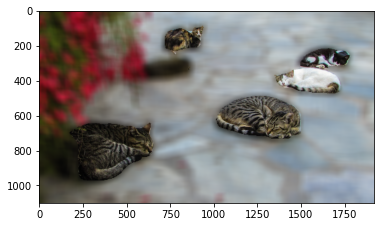

In [52]:
cats_show = cats_orig.copy()

cats_mask = seg_map.astype(np.uint8) * 255

color_mask = cv2.applyColorMap(cats_mask, cv2.COLORMAP_JET)

cats_show = cv2.addWeighted(cats_show, 0.6, color_mask, 0.4, 0.0)

plt.imshow(cv2.cvtColor(cats_show, cv2.COLOR_BGR2RGB))

cats_orig_blur = cv2.blur(cats_orig, (50,50))  

cats_mask_color = cv2.cvtColor(cats_mask, cv2.COLOR_GRAY2BGR)
cats_bg_mask = cv2.bitwise_not(cats_mask_color)
cats_bg_blur = cv2.bitwise_and(cats_orig_blur, cats_bg_mask)

cats_concat = np.where(cats_mask_color==255, cats_orig, cats_bg_blur)
plt.imshow(cv2.cvtColor(cats_concat, cv2.COLOR_BGR2RGB))
plt.show()

## ▶여성의 사진에 인물 파일 모드가 적용이 될까? -> 배경을 바꿔보기

(3413, 5120, 3)


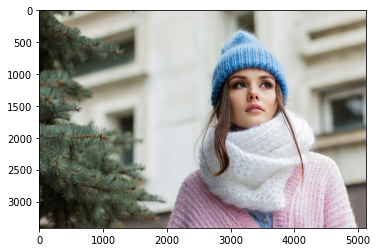

In [53]:
woman_winter_path = os.getenv('HOME')+'/aiffel/human_segmentation/images/woman_winter.png'  
woman_winter_orig = cv2.imread(woman_winter_path) 

print(woman_winter_orig.shape)
plt.imshow(cv2.cvtColor(woman_winter_orig, cv2.COLOR_BGR2RGB))
plt.show()

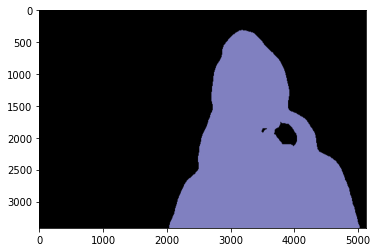

In [54]:
segvalues, output = model.segmentAsPascalvoc(woman_winter_path)
LABEL_NAMES = [
    'background', 'aeroplane', 'bicycle', 'bird', 'boat', 'bottle', 'bus',
    'car', 'cat', 'chair', 'cow', 'diningtable', 'dog', 'horse', 'motorbike',
    'person', 'pottedplant', 'sheep', 'sofa', 'train', 'tv'
]
plt.imshow(output)
plt.show()

(3413, 5120)


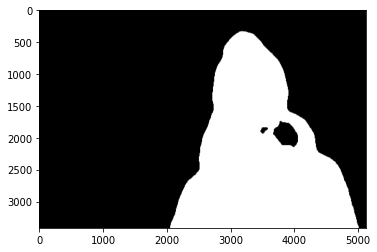

In [55]:
colormap = np.zeros((256, 3), dtype = int)
ind = np.arange(256, dtype=int)

for shift in reversed(range(8)):
    for channel in range(3):
        colormap[:, channel] |= ((ind >> channel) & 1) << shift
    ind >>= 3

seg_color = (128,128,192)

seg_map = np.all(output==seg_color, axis=-1)
print(seg_map.shape)
plt.imshow(seg_map, cmap='gray')
plt.show()

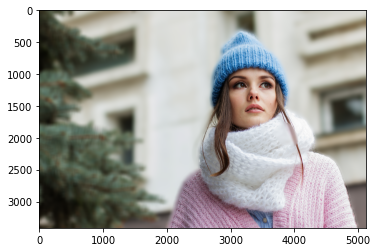

In [56]:
woman_winter_show = woman_winter_orig.copy()

woman_winter_mask = seg_map.astype(np.uint8) * 255

color_mask = cv2.applyColorMap(woman_winter_mask, cv2.COLORMAP_JET)

woman_winter_show = cv2.addWeighted(woman_winter_show, 0.6, color_mask, 0.4, 0.0)

plt.imshow(cv2.cvtColor(woman_winter_show, cv2.COLOR_BGR2RGB))

woman_winter_orig_blur = cv2.blur(woman_winter_orig, (70,70))  

woman_winter_mask_color = cv2.cvtColor(woman_winter_mask, cv2.COLOR_GRAY2BGR)
woman_winter_bg_mask = cv2.bitwise_not(woman_winter_mask_color)
woman_winter_bg_blur = cv2.bitwise_and(woman_winter_orig_blur, woman_winter_bg_mask)

woman_winter_concat = np.where(woman_winter_mask_color==255, woman_winter_orig, woman_winter_bg_blur)
plt.imshow(cv2.cvtColor(woman_winter_concat, cv2.COLOR_BGR2RGB))
plt.show()

(3413, 5120, 3)


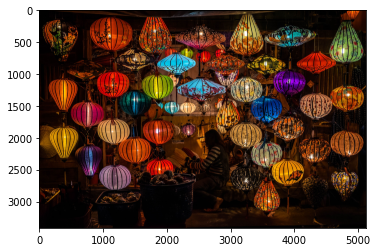

In [74]:
market_path = os.getenv('HOME')+'/aiffel/human_segmentation/images/market.png'
market = cv2.imread(market_path)
market = cv2.resize(market, dsize=(5120, 3413))
print(market.shape)
plt.imshow(cv2.cvtColor(market, cv2.COLOR_BGR2RGB))
plt.show()

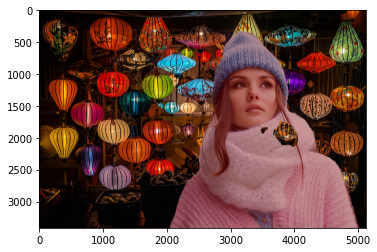

In [75]:
mask_color = cv2.cvtColor(woman_winter_mask, cv2.COLOR_BGR2RGB)
a = np.where(mask_color==255, woman_winter_show, market)
target=(woman_winter_orig.shape[1],woman_winter_orig.shape[0])
plt.imshow(cv2.cvtColor(a, cv2.COLOR_BGR2RGB))
plt.show()

## ▶색깔 필터가 씌워진 사진에도 인물 파일 모드가 적용이 될까?->노란색 배경으로 바꾸기

(2937, 6962, 3)


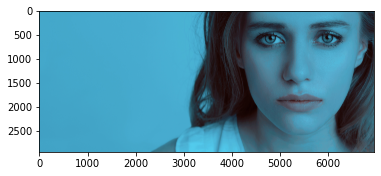

In [57]:
blue_path = os.getenv('HOME')+'/aiffel/human_segmentation/images/blue.png'  
blue_orig = cv2.imread(blue_path) 

print(blue_orig.shape)
plt.imshow(cv2.cvtColor(blue_orig, cv2.COLOR_BGR2RGB))
plt.show()

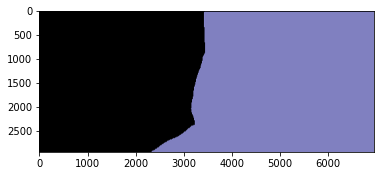

In [58]:
segvalues, output = model.segmentAsPascalvoc(blue_path)
LABEL_NAMES = [
    'background', 'aeroplane', 'bicycle', 'bird', 'boat', 'bottle', 'bus',
    'car', 'cat', 'chair', 'cow', 'diningtable', 'dog', 'horse', 'motorbike',
    'person', 'pottedplant', 'sheep', 'sofa', 'train', 'tv'
]
plt.imshow(output)
plt.show()

In [59]:
for class_id in segvalues['class_ids']:
    print(LABEL_NAMES[class_id])

background
person


(2937, 6962)


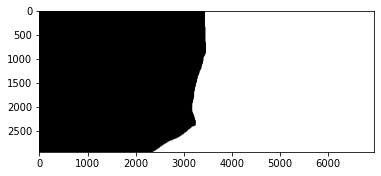

In [60]:
colormap = np.zeros((256, 3), dtype = int)
ind = np.arange(256, dtype=int)

for shift in reversed(range(8)):
    for channel in range(3):
        colormap[:, channel] |= ((ind >> channel) & 1) << shift
    ind >>= 3

seg_color = (128,128,192)

seg_map = np.all(output==seg_color, axis=-1)
print(seg_map.shape)
plt.imshow(seg_map, cmap='gray')
plt.show()

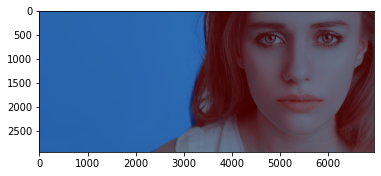

In [61]:
blue_show = blue_orig.copy()

blue_mask = seg_map.astype(np.uint8) * 255

color_mask = cv2.applyColorMap(blue_mask, cv2.COLORMAP_JET)

blue_show = cv2.addWeighted(blue_show, 0.6, color_mask, 0.4, 0.0)

plt.imshow(cv2.cvtColor(blue_show, cv2.COLOR_BGR2RGB))
plt.show()

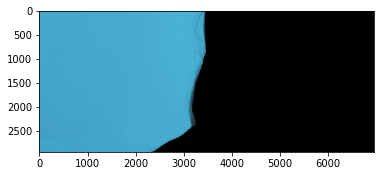

In [62]:
blue_orig_blur = cv2.blur(blue_orig, (13,13))  
blue_mask_color = cv2.cvtColor(blue_mask, cv2.COLOR_GRAY2BGR)
blue_bg_mask = cv2.bitwise_not(blue_mask_color)
blue_bg_blur = cv2.bitwise_and(blue_orig_blur, blue_bg_mask)
plt.imshow(cv2.cvtColor(blue_bg_blur, cv2.COLOR_BGR2RGB))
plt.show()

(2937, 6962, 3)


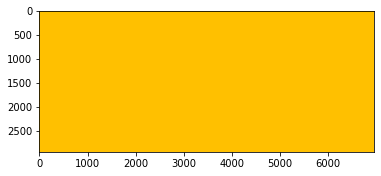

In [63]:
yellow_path = os.getenv('HOME')+'/aiffel/human_segmentation/images/yellow.png'
yellow = cv2.imread(yellow_path)
yellow = cv2.resize(yellow, dsize=(6962, 2937))
print(yellow.shape)
plt.imshow(cv2.cvtColor(yellow, cv2.COLOR_BGR2RGB))
plt.show()

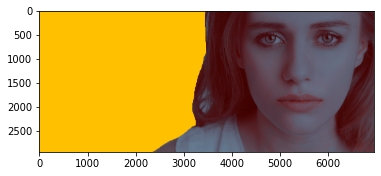

In [64]:
mask_color = cv2.cvtColor(blue_mask, cv2.COLOR_BGR2RGB)
b = np.where(mask_color==255, blue_show, yellow)
target=(blue_orig.shape[1],blue_orig.shape[0])
plt.imshow(cv2.cvtColor(b, cv2.COLOR_BGR2RGB))
plt.show()

## ▶어두운 사진에도 인물 파일 모드가 적용이 될까?->노란색 배경으로 바꾸기

(3261, 5000, 3)


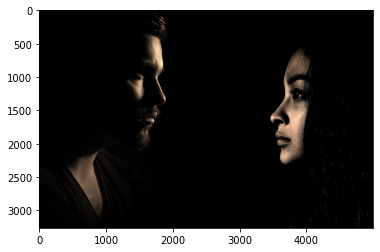

In [65]:
dark_path = os.getenv('HOME')+'/aiffel/human_segmentation/images/dark.png'  
dark_orig = cv2.imread(dark_path) 

print(dark_orig.shape)
plt.imshow(cv2.cvtColor(dark_orig, cv2.COLOR_BGR2RGB))
plt.show()

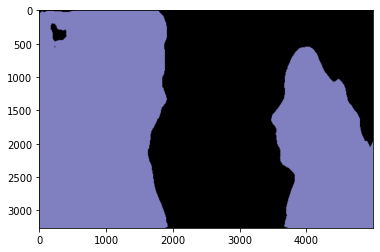

In [66]:
segvalues, output = model.segmentAsPascalvoc(dark_path)
LABEL_NAMES = [
    'background', 'aeroplane', 'bicycle', 'bird', 'boat', 'bottle', 'bus',
    'car', 'cat', 'chair', 'cow', 'diningtable', 'dog', 'horse', 'motorbike',
    'person', 'pottedplant', 'sheep', 'sofa', 'train', 'tv'
]
plt.imshow(output)
plt.show()

(3261, 5000)


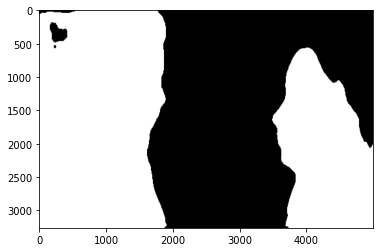

In [67]:
colormap = np.zeros((256, 3), dtype = int)
ind = np.arange(256, dtype=int)

for shift in reversed(range(8)):
    for channel in range(3):
        colormap[:, channel] |= ((ind >> channel) & 1) << shift
    ind >>= 3

seg_color = (128,128,192)

seg_map = np.all(output==seg_color, axis=-1)
print(seg_map.shape)
plt.imshow(seg_map, cmap='gray')
plt.show()

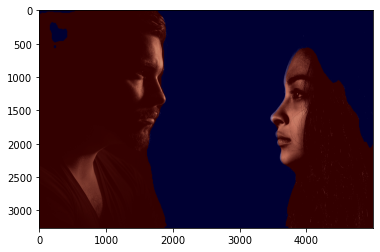

In [68]:
dark_show = dark_orig.copy()

dark_mask = seg_map.astype(np.uint8) * 255

color_mask = cv2.applyColorMap(dark_mask, cv2.COLORMAP_JET)

dark_show = cv2.addWeighted(dark_show, 0.6, color_mask, 0.4, 0.0)

plt.imshow(cv2.cvtColor(dark_show, cv2.COLOR_BGR2RGB))
plt.show()

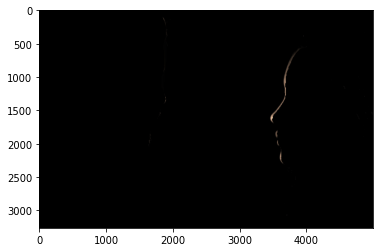

In [69]:
dark_orig_blur = cv2.blur(dark_orig, (13,13))  
dark_mask_color = cv2.cvtColor(dark_mask, cv2.COLOR_GRAY2BGR)
dark_bg_mask = cv2.bitwise_not(dark_mask_color)
dark_bg_blur = cv2.bitwise_and(dark_orig_blur, dark_bg_mask)
plt.imshow(cv2.cvtColor(dark_bg_blur, cv2.COLOR_BGR2RGB))
plt.show()

(3261, 5000, 3)


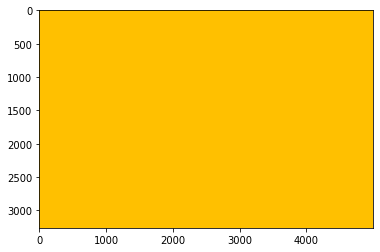

In [70]:
yellow_path = os.getenv('HOME')+'/aiffel/human_segmentation/images/yellow.png'
yellow = cv2.imread(yellow_path)
yellow = cv2.resize(yellow, dsize=(5000, 3261))
print(yellow.shape)
plt.imshow(cv2.cvtColor(yellow, cv2.COLOR_BGR2RGB))
plt.show()

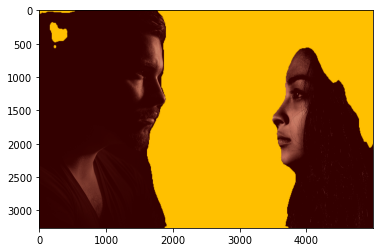

In [71]:
mask_color = cv2.cvtColor(dark_mask, cv2.COLOR_BGR2RGB)
c = np.where(mask_color==255, dark_show, yellow)
target=(blue_orig.shape[1],dark_orig.shape[0])
plt.imshow(cv2.cvtColor(c, cv2.COLOR_BGR2RGB))
plt.show()

# Step 2. 사진에서 문제점 찾기

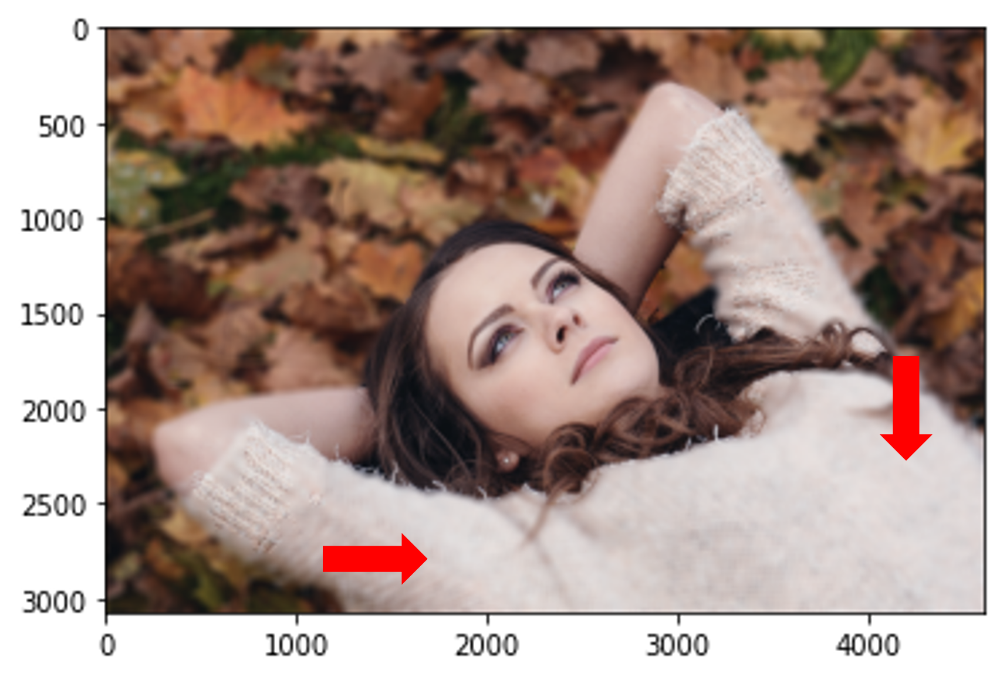

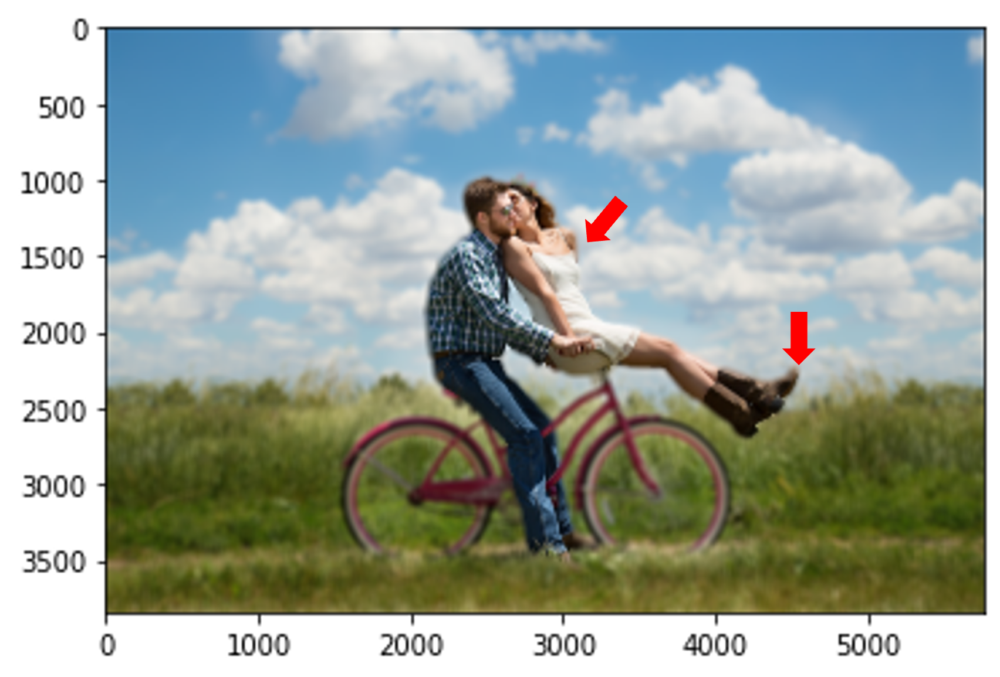

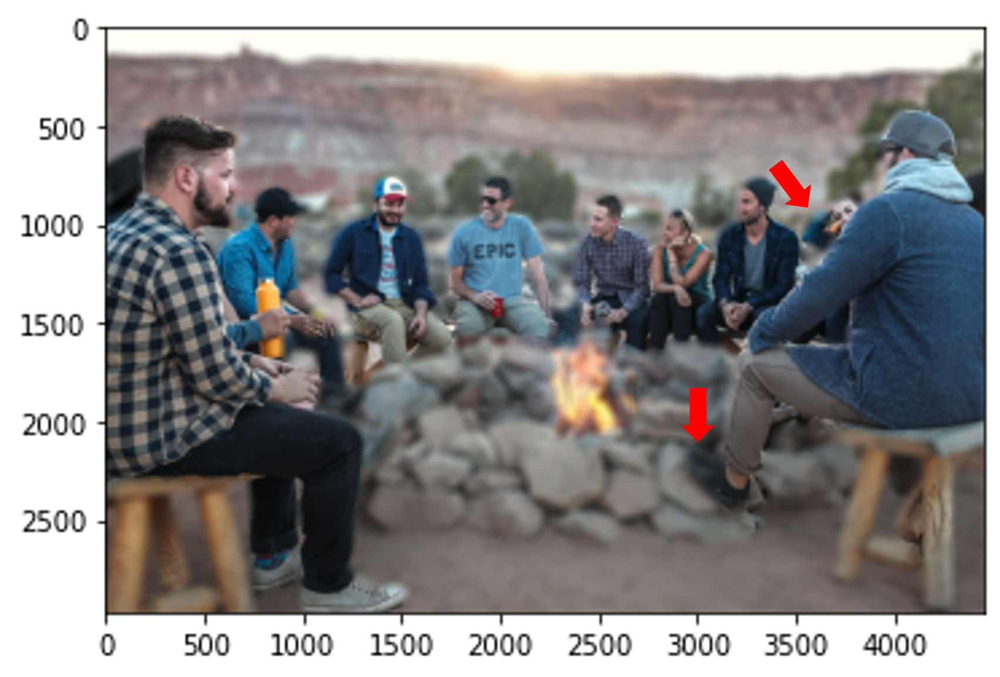

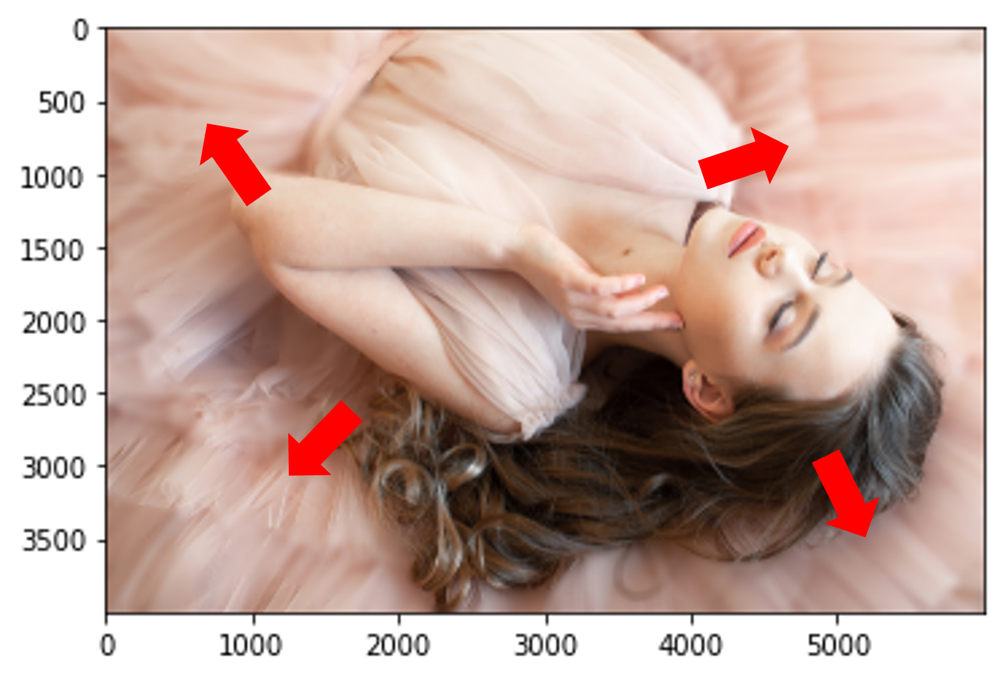

### 강아지 사진의 경우, 오류 없이 제대로 인식했다.

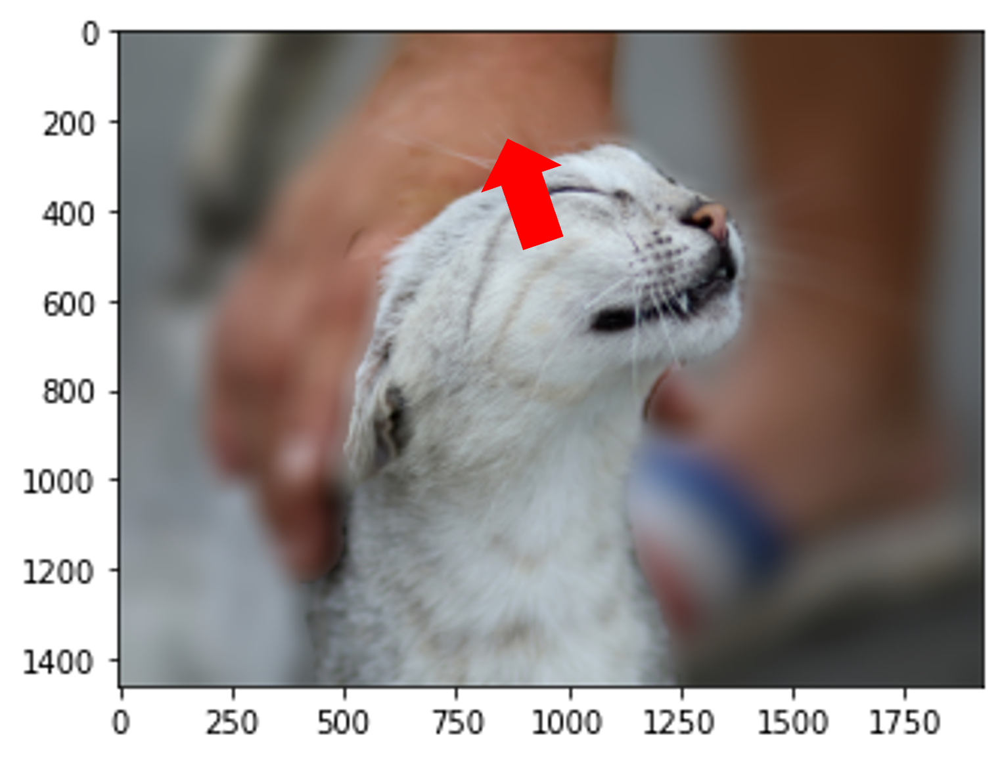

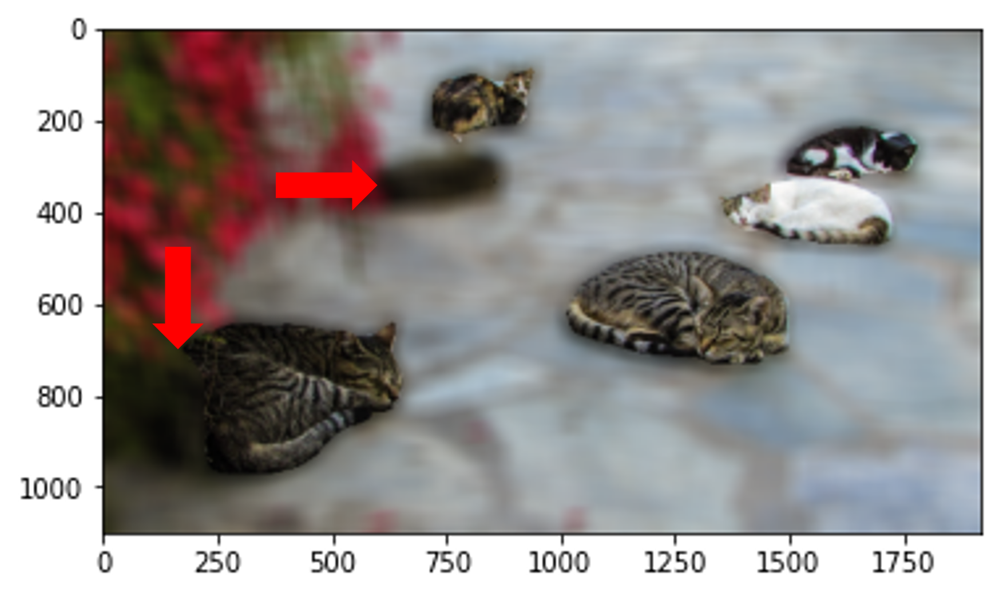

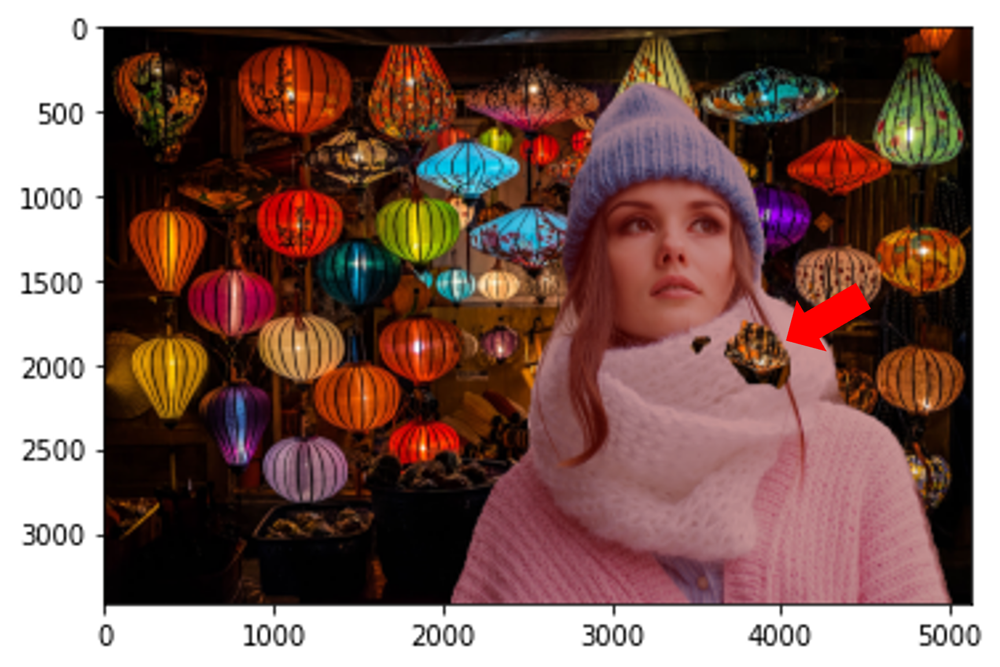

### 색깔 필터가 씌워진 사진의 경우, 오류 없이 제대로 인식했다.

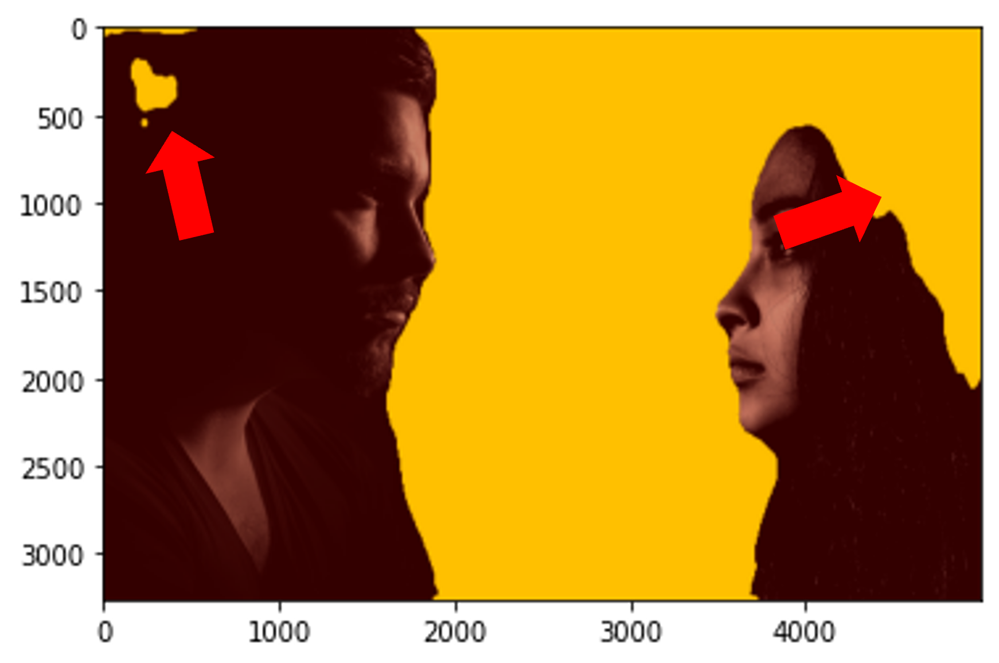

## ▶흑백 사진에도 인물 파일 모드가 적용이 될까? (+ 의족)

(3321, 4649, 3)


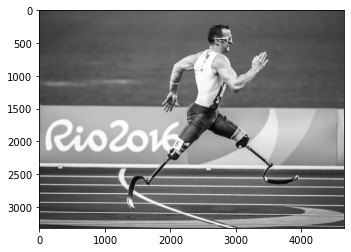

In [72]:
action_path = os.getenv('HOME')+'/aiffel/human_segmentation/images/action.png'  
action_orig = cv2.imread(action_path) 

print(action_orig.shape)
plt.imshow(cv2.cvtColor(action_orig, cv2.COLOR_BGR2RGB))
plt.show()

In [73]:
segvalues, output = model.segmentAsPascalvoc(action_path)

ValueError: not enough values to unpack (expected 3, got 2)

# REPORT
사진을 아무리 화질이 좋은 것으로 준비해도 쥬피터 노트북에 불러오면 흐릿해져서 조금 아쉬웠다.
사진을 바꾸는 것이다보니 엄청 기대하면서 시작할때 엄청나게 많은 사진을 구해서 왔다. 아쉽게도 인식할 수 있는 라벨에 한계가 있어서 지울 수 밖에 없었다... 전에 했던 노드를 찾아보면서 답을 알아갈때 즐거운 것 같다!

### 문제점
생각 보다 많은 사진에서 블러처리가 제대로 되지 않았다. segmentation에 여러 라벨들이 있었지만, 인물이 입고 있는 옷이라던지, 생각과 다른 모습(예를 들면 두개의 고양이 사진과 같이)에서는 제대로 인식을 하지 못하는 모습이 보인다. 반면에 강아지 사진이나 색깔 필터가 씌여진 사진의 경우에는 제대로 인식하는 모습이 보였다. 90퍼센트는 모습으로 인식하고 10퍼센트정도는 색으로 인식을 하는 듯 하다.
여성+마켓 사진에서 여성이 살짝 분홍색으로 바뀌었다. 왜 이런걸까..?
아쉽게도 제일 기대했던 흑백사진+의족은 모델을 제대로 불러내지 못했다. 그래서 검색을 해봤으나, 변수가 많아서 그렇다고 하는데, 해당 사진 말고 다른 사진으로 하니 잘되는 것으로 봐서는 사진 자체의 문제인 것 같았다. 이후에 도움을 요청했으나 문제를 해결하지 못했다...